In [1]:
# Import required libraries
import os

os.environ["KMP_DUPLICATE_LIB_OK"] = "TRUE" #Corrects crashing issues in windows

import numpy as np
import matplotlib.pyplot as plt
import pymoo
import scipy

# pymoo sub sections
# from pymoo.core.problem import Problem
from pymoo.core.problem import ElementwiseProblem
from pymoo.algorithms.moo.nsga2 import NSGA2
from pymoo.core.variable import Real, Integer, Choice, Binary
from pymoo.core.mixed import MixedVariableMating, MixedVariableGA, MixedVariableSampling, MixedVariableDuplicateElimination
from pymoo.optimize import minimize

# Utiliies for working with linkages (DeCoDE Lab)
from linkage_utils import *

# Other modules
import json
from IPython.display import HTML
import matplotlib.animation as animation
from tqdm.autonotebook import trange
import pickle

# Set random seed for consistency
np.random.seed(5)

100%|██████████| 6/6 [00:19<00:00,  3.29s/it]


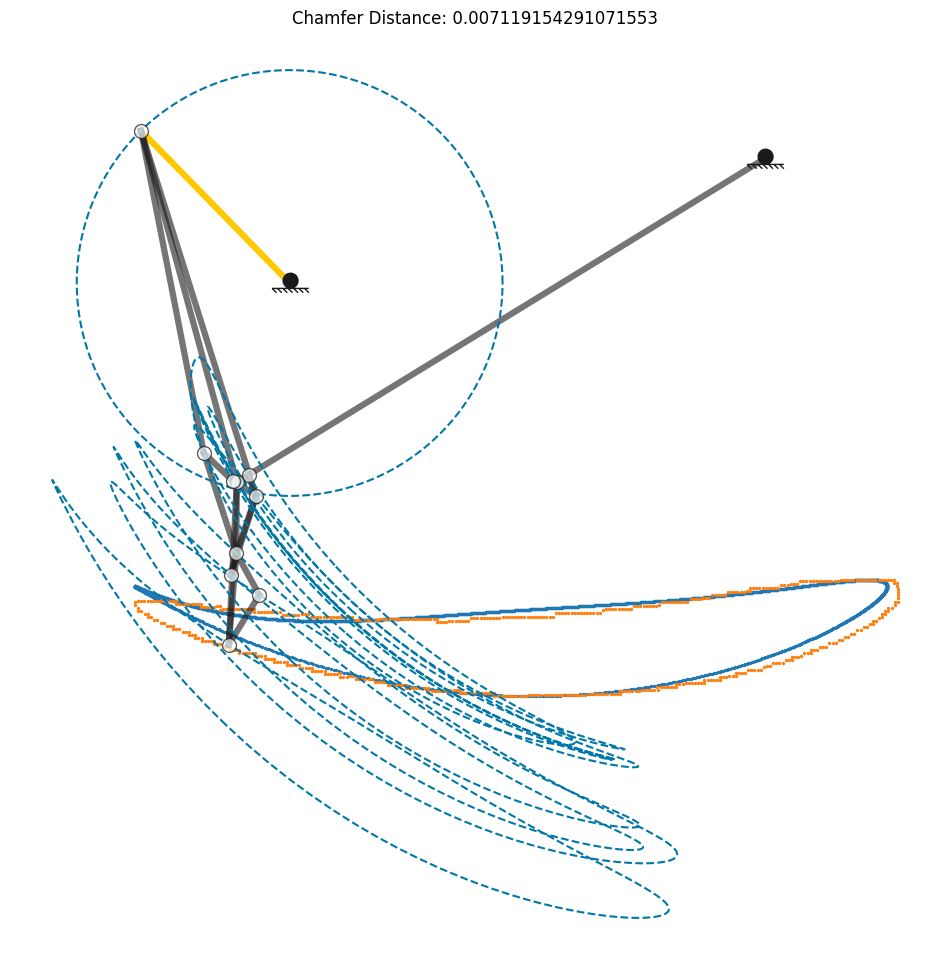

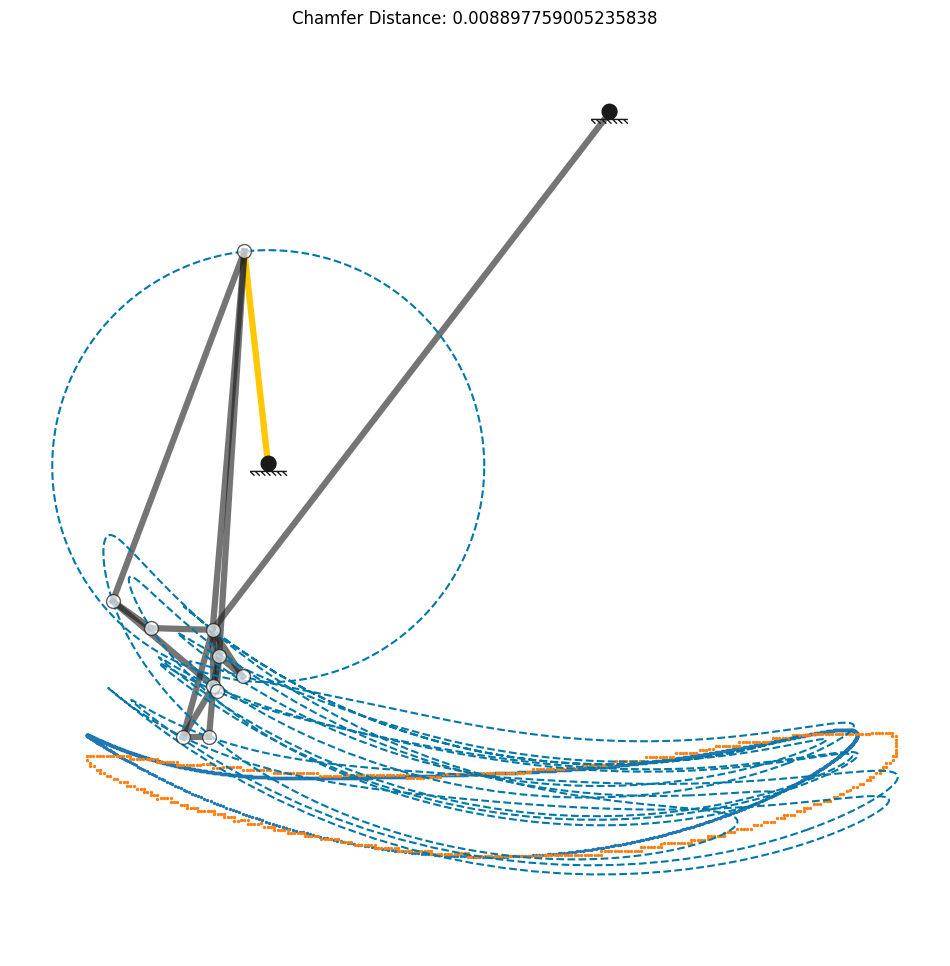

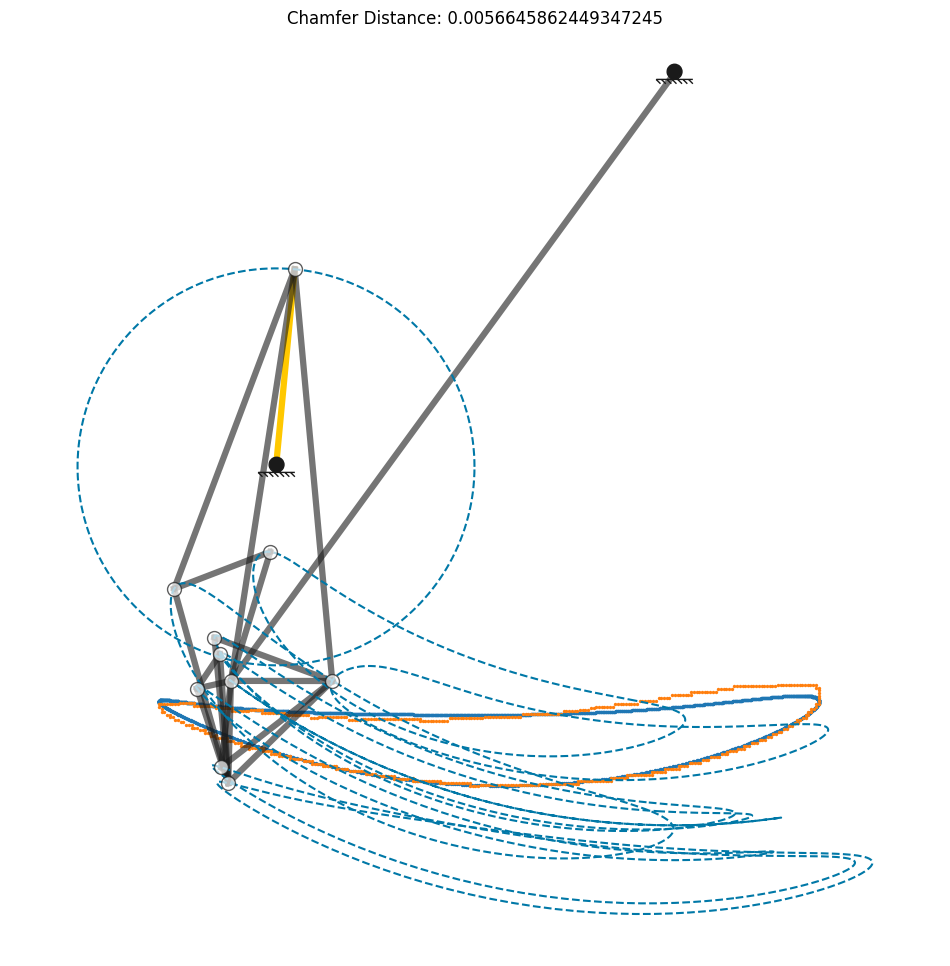

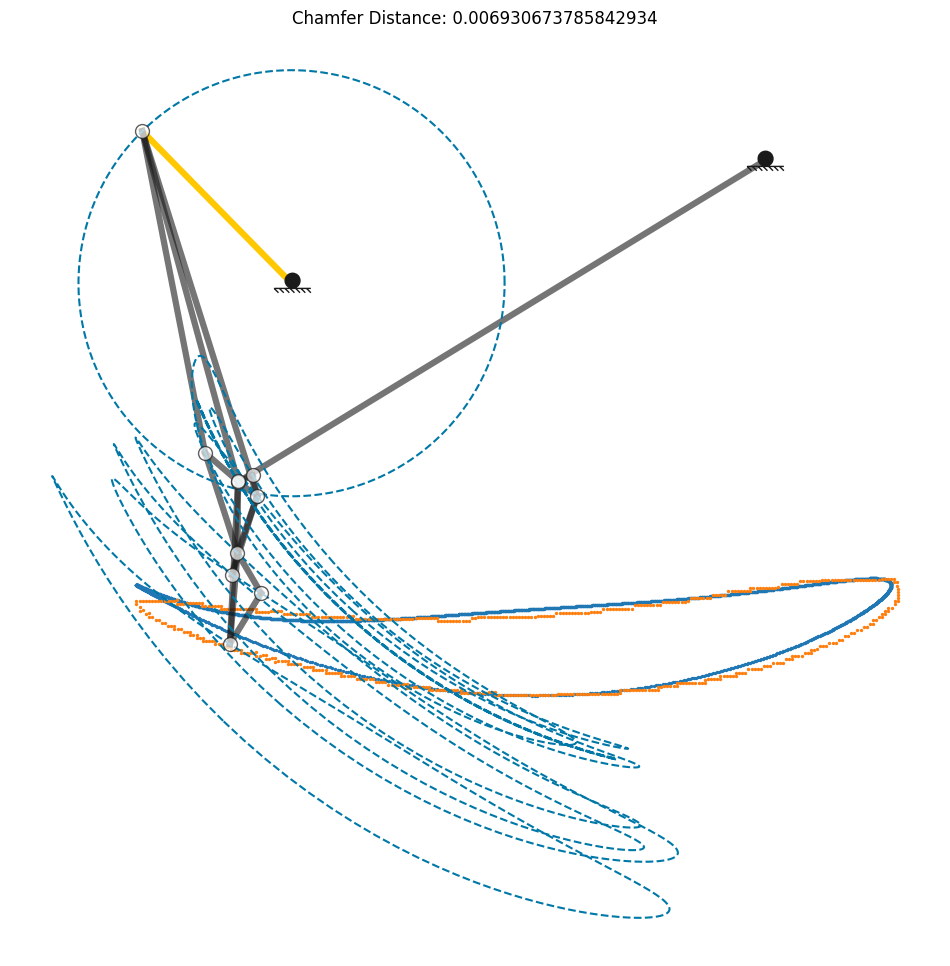

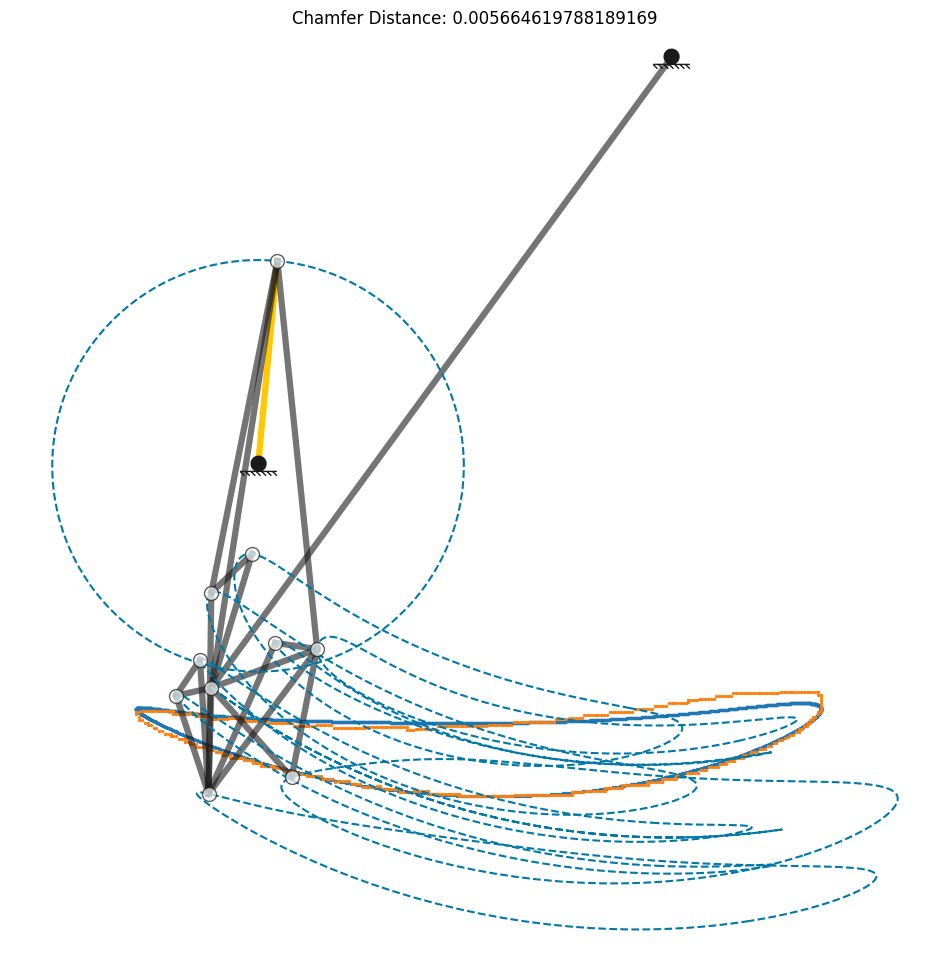

...

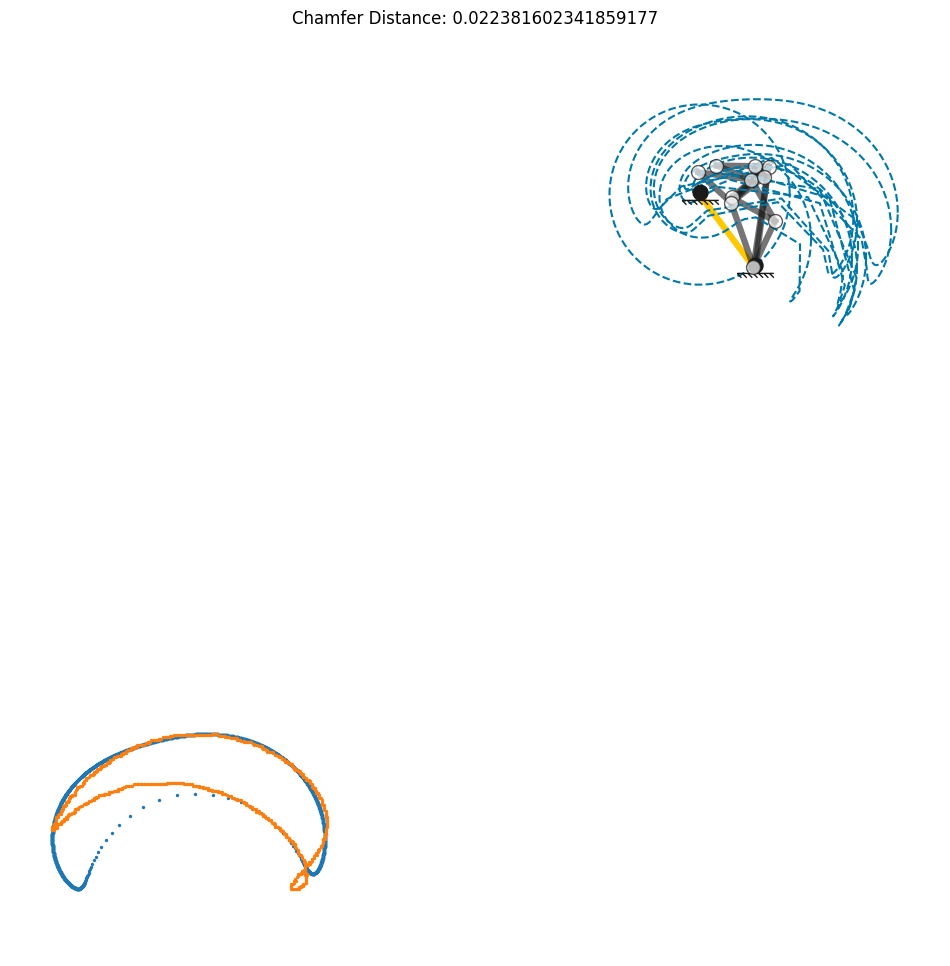

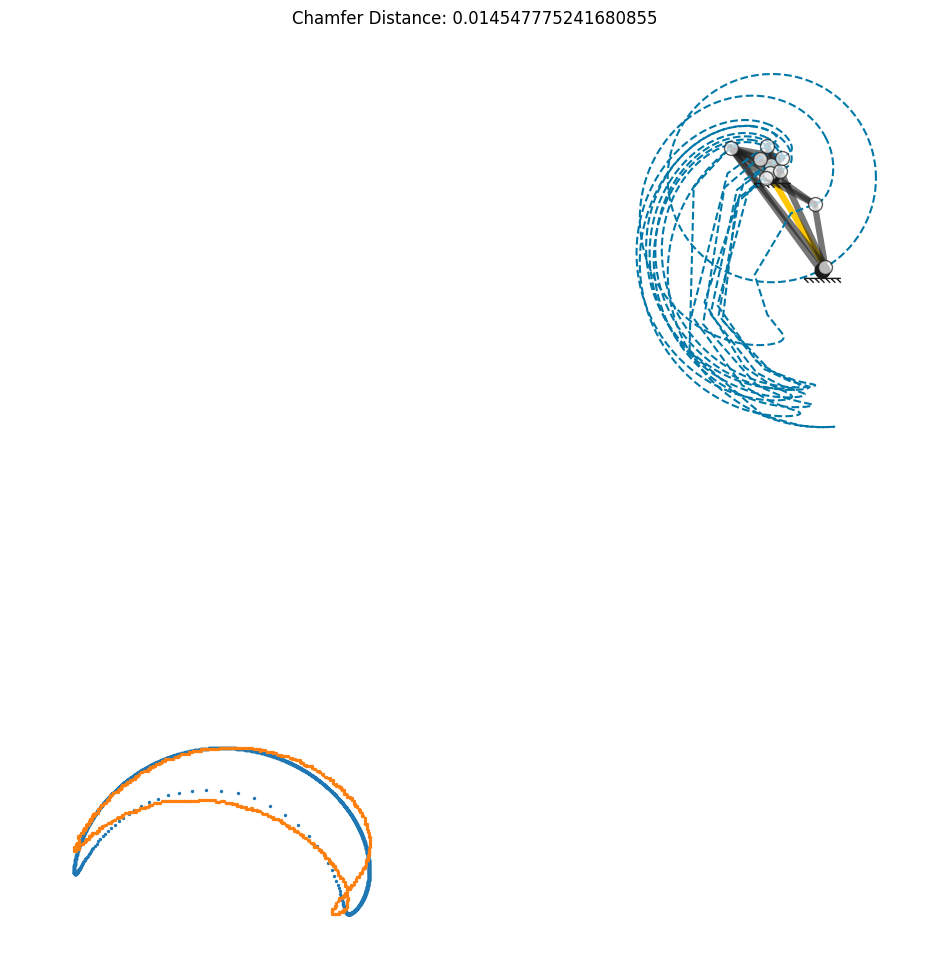

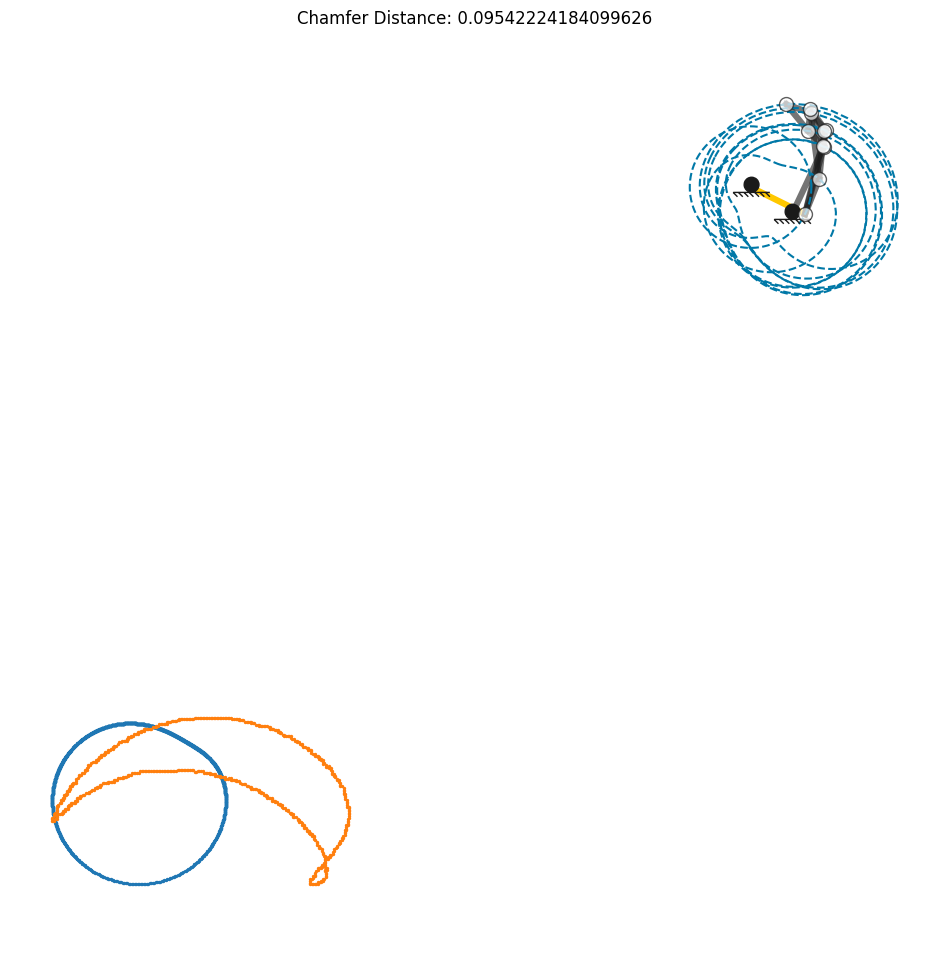

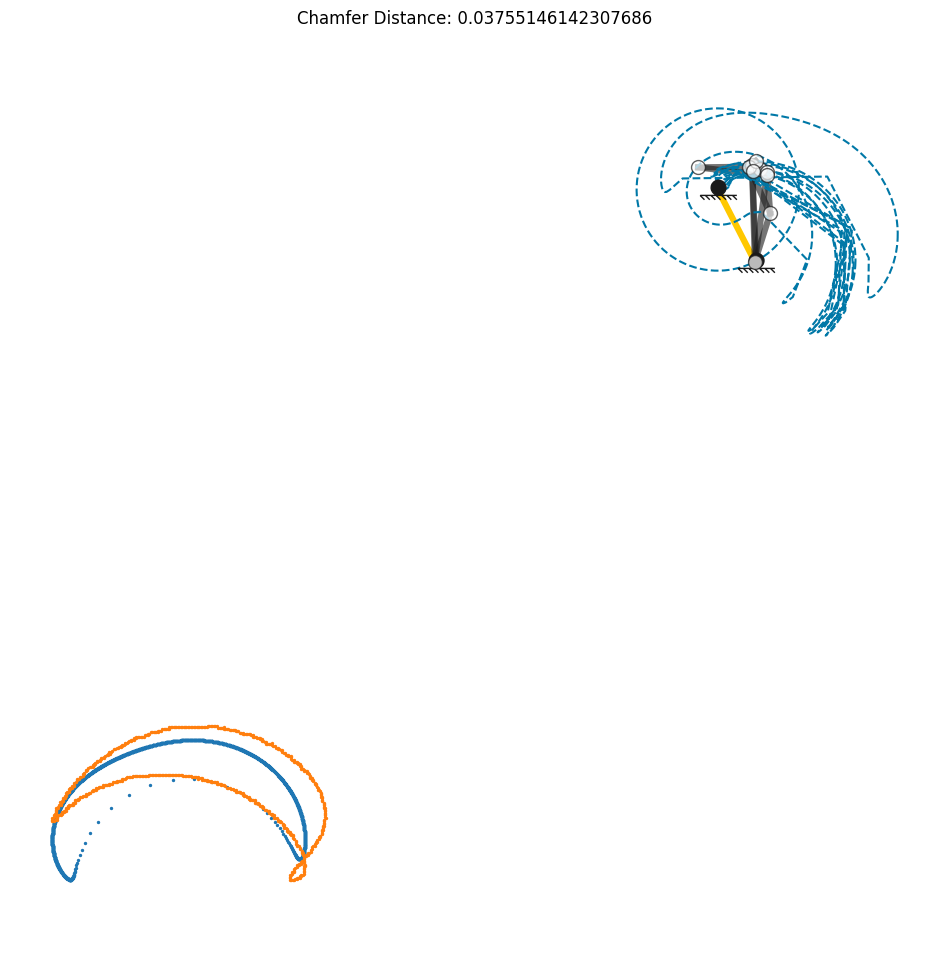

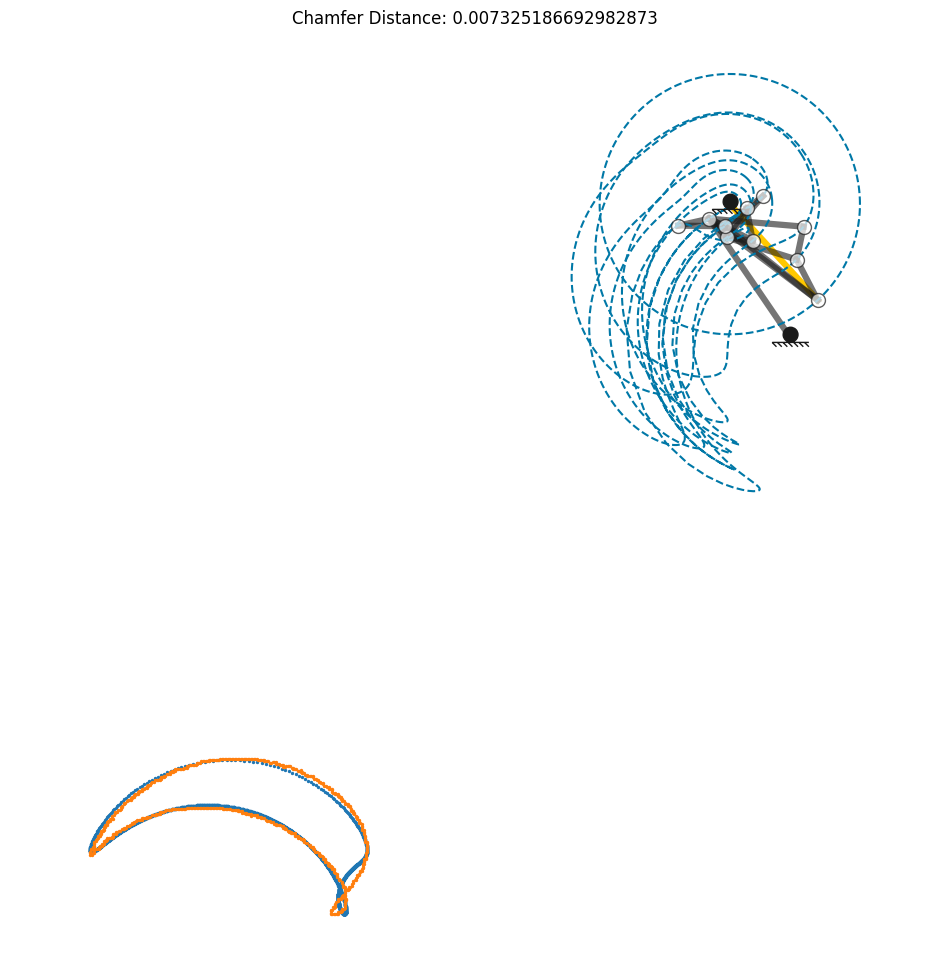

In [9]:



target_curves = []

for i in range(6):
    if not os.path.exists('./data/%i.csv'%(i)):
        raise IOError('Could not find %i.csv in the data folder'%(i))
    target_curves.append(np.loadtxt('./data/%i.csv'%(i),delimiter=','))


for i in trange(6):
    if os.path.exists('./results/%i.csv'%i):
        
        mechanisms = get_population_csv('./results/%i.csv'%i)
        F = []
        for m in mechanisms:
            C,x0,fixed_nodes,motor,target = from_1D_representation(m)
            draw_mechanism(C,x0,fixed_nodes,motor)
           
            comparecurves(C, x0, fixed_nodes, motor, target, target_curves[i])
            



In [ ]:
if not results.X is None:
    # Step 1: Reshape
    target, C, x0, fixed_nodes, motor  = problem.convert_1D_to_mech(best_sol)
    # target, C, x0, fixed_nodes, motor  = problem.fix_mechanism(target, C, x0, fixed_nodes, motor )
    # Step 2: Draw
    draw_mechanism(C,x0,fixed_nodes,motor)

else:
    print('Did Not Find Solutions!!')

In [2]:
def comparecurves(C, x, fixed_nodes, motor, target, target_pc):
    valid, CD, mat, sol = evaluate_mechanism(C,x,fixed_nodes, motor, target_pc, idx=target,device='cpu',timesteps=2000)
    target_pc = get_oriented(target_pc)
    plt.scatter(sol[:,0],sol[:,1],s=2)
    plt.scatter(target_pc[:,0],target_pc[:,1],s=2)
    plt.title(f"Chamfer Distance: {CD}")
    plt.axis('equal')
if not results.X is None:
    comparecurves(C, x0, fixed_nodes, motor, target, target_curve)
else:
    print('Did Not Find Solutions!!')


NameError: name 'results' is not defined

Now lets see the solution with the least material use

Now lets visualize the pareto front of the last generation

  0%|          | 0/54 [00:00<?, ?it/s]

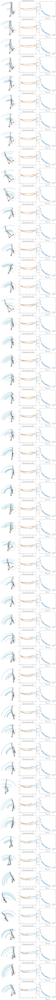

In [31]:



if not results.X is None:
    # first get generalized 1D representation
    mechanisms = []

    for x in results.pop.get("X"):
        target, C, x0, fixed_nodes, motor  = problem.convert_1D_to_mech(x)
        mechanisms.append(to_final_representation(C,x0,fixed_nodes,motor,target))
    # Visualize Pareto Front
    visualize_pareto_front(np.array(mechanisms),results.pop.get("F"),target_curve)
else:
    print('Did Not Find Solutions!!')